<a href="https://colab.research.google.com/github/IvanOfficial/Homework1/blob/master/Optimisation_Gerasimov.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Домашнее задание 1. 

Присылайте .pdf файл, сохраненный из этого ноутбука (можно просто нажать `Ctrl + P`) на `homework@merkulov.top`.

**Дедлайн: 28.03.21 23:59:59**

# Convergence speed

1. Show with the definition that the sequence $\left\{ \dfrac{1}{k} \right\}_{k=1}^\infty$ does not have a linear convergence rate (but it converges to zero).
1. Determine the convergence or divergence of a given sequence $r_{k} = 0.707^k$.
1. Determine the convergence or divergence of a given sequence $r_{k} = 0.707^{2^k}$.
1. Determine the convergence or divergence of a given sequence $r_{k} = \frac{1}{k!}$.
1. Determine the convergence or divergence of a given sequence $r_k =\begin{cases} \frac{1}{k}, & \mbox{if } k\mbox{ is even} \\ \frac{1}{k^2}, & \mbox{if } k\mbox{ is odd} \end{cases}$.

# Line search

1. Consider the function $$f(x) = (x + \sin x) e^x, \;\;\; x \in [-20, 0]$$ 
    ![](https://raw.githubusercontent.com/MerkulovDaniil/optim/master/docs/exercises/Unimodal.svg)

    Consider the following modification of solution localization method, in which the interval $[a,b]$ is divided into $2$ parts in a fixed proportion of $t: x_t = a + t*(b-a)$ (maximum twice at iteration - as in the dichotomy method). Experiment with different values of $t \in [0,1]$ and plot the dependence of $N (t)$ - the number of iterations needed to achieve $\varepsilon$ - accuracy from the $t$ parameter. Consider $\varepsilon = 10^{-7}$. Note that with $t = 0.5$ this method is exactly the same as the dichotomy method.

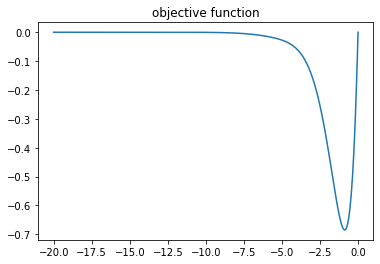

In [ ]:
### YOUR CODE HERE
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

def f(x):
  return (x + np.sin(x)) * np.exp(x)

def x_t(a, b, t):
  return a + t * (b - a)



def StopCondition(x1, x2, eps):
  return np.abs(x1 - x2) < eps

def RequestOracle(x1, x2):
  return f(x1), f(x2)

def NextPoint(a, b, x1, x2, f1, f2, t):
  if f1 <= f2:
    return a, x2, x1, x_t(a, x2, t)
  else:
    return x1, b, x2, x_t(x1, b, t)

def swap(x1, x2):
  if x1 > x2:
    return x2, x1
  else:
    return x1, x2

def model(x_start, a, b, t, eps):
  x1 = x_start
  x2 = x_t(a, b, t)
  x1, x2 = swap(x1, x2)
  fa, fb = RequestOracle(a, b)
  n = 0
  while not StopCondition(x1, x2, eps):
    f1, f2 = RequestOracle(x1, x2)
    a, b, x1, x2 = NextPoint(a, b, x1, x2, f1, f2, t)
    x1, x2 = swap(x1, x2)
    # print(x2)
    n += 1
  return x2, n



eps = 1e-7

x = np.linspace(-20, 0, 500)
# plt.figure(1)
plt.plot(x, f(x))
plt.title('objective function')
plt.show()

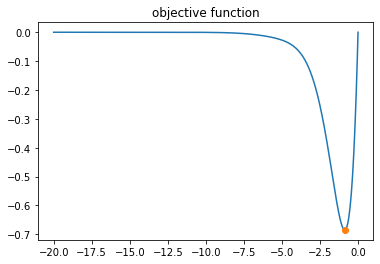

In [ ]:
# check work
plt.plot(x, f(x))
plt.title('objective function')
x_start = x.min() + 0.2 * (x.max() - x.min())

t = 0.3
out, n = model(x_start, x.min(), x.max(), t, eps)
plt.plot(out, f(out), 'o')
plt.show()

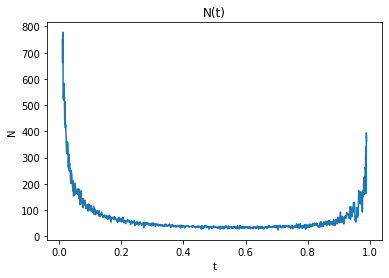

In [ ]:
# dependence of N(t)

t = np.linspace(0.01, 0.99, 1000)
N_t = np.zeros_like(t)
for i in tqdm(range(t.shape[0])):
  _, N_t[i] = model(x_start, x.min(), x.max(), t[i], eps)

plt.plot(t, N_t)
plt.title('N(t)')
plt.xlabel('t')
plt.ylabel('N')
plt.show()

# Zero order optimization

## Global optimization with scipy
Implement Rastrigin function $f: \mathbb{R}^d \to \mathbb{R}$ for d = 10. [link](https://www.sfu.ca/~ssurjano/rastr.html)

$$
f(\mathbf{x})=10 d+\sum_{i=1}^{d}\left[x_{i}^{2}-10 \cos \left(2 \pi x_{i}\right)\right]
$$

* Consider global optimization from [here](https://docs.scipy.org/doc/scipy/reference/optimize.html#global-optimization).
* Plot 4 graphs for different $d$ from {2,4,8,16,32}. On each graph you are to plot $f$ from $N_{fev}$ for 5 methods: `basinhopping`, `brute`, `differential_evolution`, `shgo`, `dual_annealing` from scipy, where $N_{fev}$ - the number of function evaluations. This information is usually avalable from `specific_optimizer.nfev`. If you will need bounds for the optimizer, use $x_i \in [-5, 5]$.

## Hyperparameter search with optuna
Machine learning models often have hyperparameters. To choose optimal one between them one can use GridSearch or RandomSearch. But these algorithms computationally uneffective and don't use any sort of information about type of optimized function. To overcome this problem one can use [bayesian optimization](https://distill.pub/2020/bayesian-optimization/). Using this method we optimize our model by sequentially chosing points based on prior information about function. ![Image](https://www.resibots.eu/limbo/_images/bo_concept.png). 

In this task you will use [optuna](https://optuna.org/) package for hyperparameter optimization RandomForestClassifier. Your task is to find best Random Forest model varying at least 3 hyperparameters on iris dataset. Examples can be find [here](https://optuna.org/#code_examples) or [here](https://colab.research.google.com/github/optuna/optuna/blob/master/examples/quickstart.ipynb)

In [ ]:
%%capture
!pip install optuna
!pip install plotly

In [ ]:
import sklearn.datasets
import sklearn.ensemble
import sklearn.model_selection
import sklearn.svm
import numpy as np

import optuna

iris = sklearn.datasets.load_iris()
x, y = iris.data, iris.target

In [ ]:
print(x.shape, y.shape)

(150, 4) (150,)


In [ ]:
# Here is the example of objective function, which depends on two variables (n_estimators, max_depth). But you'll need to choose at least 3.
def objective():
    iris = sklearn.datasets.load_iris()  # Prepare the data.
    
    clf = sklearn.ensemble.RandomForestClassifier(    
        n_estimators=5, max_depth=3)  # Define the model.
    
    return sklearn.model_selection.cross_val_score(
        clf, iris.data, iris.target, n_jobs=-1, cv=3).mean()  # Train and evaluate the model.

print('Accuracy: {}'.format(objective()))

Accuracy: 0.9533333333333333


In [ ]:
### YOUR CODE HERE


def RASTRIGIN_FUNCTION_(x): # x.shape = [dimension]
  return 10 * x.shape[0] + (np.power(x, 2) - 10 * np.cos(2 * np.pi * x)).sum(axis=0)


RASTRIGIN_FUNCTION = np.vectorize(RASTRIGIN_FUNCTION_, signature='(d)->()')


def get_z(d=2):
  dim = []
  for i in range(d):
    x = np.arange(-5.12, 5.12, 0.1)
    dim.append(x)
  xx = np.meshgrid(*dim)
  xx = np.stack(xx).T
  return RASTRIGIN_FUNCTION(xx)

In [ ]:
# x = np.arange(-5.12, 5.12, 0.1)

# y = np.arange(-5.12, 5.12, 0.1)

# xx, yy, zz = np.meshgrid(*[x, x, x])
# grid = np.stack((xx, yy, zz)).T
# grid.shape


In [ ]:
z = get_z(d=3)
print(z.shape)

(103, 103, 103)


In [ ]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
fig.update_layout(title='RASTRIGIN_FUNCTION', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

In [ ]:



# fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
# fig.update_traces(contours_z=dict(show=True, usecolormap=True,
#                                   highlightcolor="limegreen", project_z=True))
# fig.update_layout(title='RASTRIGIN_FUNCTION', autosize=False,
#                   scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
#                   width=1000, height=1000,
#                   margin=dict(l=65, r=50, b=65, t=90)
# )

# fig.show()

# Gradient descent

## [Hobbit village](https://courses.cs.ut.ee/MTAT.03.227/2015_spring/uploads/Main/home-exercises-5.pdf)

In [ ]:
%matplotlib inline
import numpy as np
from matplotlib import pyplot as plt
import matplotlib as mpl
import seaborn as sns
import copy
sns.set()

Below one can find function plotting the village

In [ ]:
def plot_village(coordinates, l=1):
    # Checking, that all the coordinates are less than l
    assert (coordinates <= l).all(), 'All the houses should be in a village'
    
    # Draw horizontal line
    plt.hlines(0, 0, l)
    plt.xlim(0, l)
    plt.ylim(-0.5, 0.5)
    
    # Draw house points
    y = np.zeros(np.shape(coordinates))
    plt.title('The Hobbit Village')
    plt.plot(coordinates,y,'o',ms = 10)
    plt.axis('off')
    plt.xlabel('Coordinates')
    fig = plt.gcf()
    fig.set_size_inches(15, 1)
    plt.show()

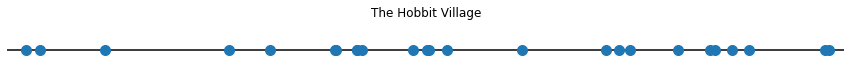

In [ ]:
N = 25
l = 1
x = np.random.rand(N)*l
    
plot_village(x, l)

The inhabitants of a one-dimensional village want to connect to the Internet, so they need a central service station from which a cable will stretch to all the houses in the village. Let the price of the cable to be pulled from the station to each house independently be determined by some function p(d) . Then it is clear that the village will have to pay the following amount for access to the World Wide Web:
$$
P(w, x) = \sum\limits_{i=1}^N p(d_i) = \sum\limits_{i=1}^N p(|w - x_i|)
$$
$w$ - station location, $x_i$ - location of $i$ house.

Write analytical solution $w^*$ for minimization $P(w,x)$, if $p(d) = d^2$

$\nabla_{\omega} P(\omega, x) = \sum \limits_{i=1}^{N} 2 \cdot (\omega - x_i) = 0 \Rightarrow \omega^{*} = \frac{1}{N} \sum \limits_{i=1}^{N} x_i = \bar{x}$

Write loss function $P(x,w)$

In [ ]:
def P(w, x):
    return ((w - x)**2).sum()

Plot loss function on the range $(0, l)$

Text(0.5, 1.0, '$P(w, x)$')

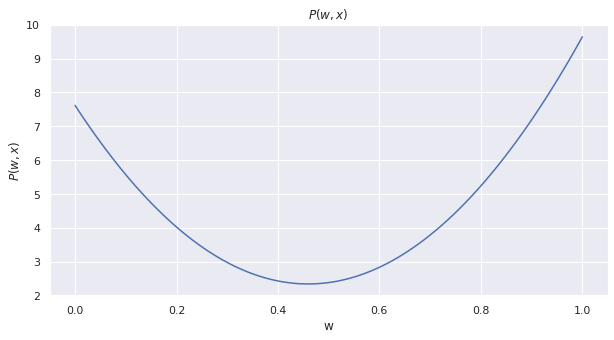

In [ ]:
w = np.linspace(0, l, 100)
res_p = np.array([P(i, x) for i in w])

plt.figure(figsize=(10, 5))
plt.plot(w, res_p)
plt.xlabel('w')
plt.ylabel(r'$P(w, x)$')
plt.title(r'$P(w, x)$')

Write gradient of loss function

In [ ]:
def dP(w, x):
    return 2 * (w - x).sum()

Plot gradient of loss function on the range $(0,l)$. Which point on the graph is of particular interest? Why?

Text(0.5, 1.0, '$\\nabla P(w, x)$')

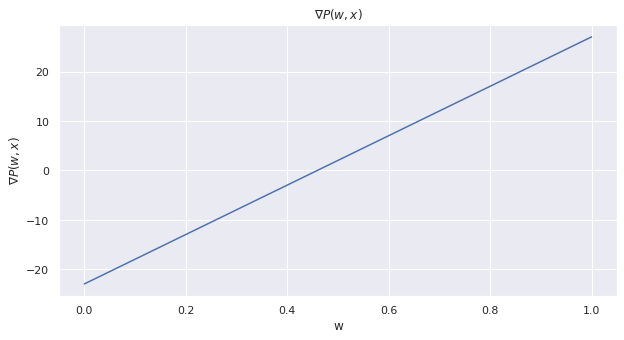

In [ ]:
w = np.linspace(0, l, 100)
res_p = np.array([dP(i, x) for i in w])

plt.figure(figsize=(10, 5))
plt.plot(w, res_p)
plt.xlabel('w')
plt.ylabel(r'$\nabla P(w, x)$')
plt.title(r'$\nabla P(w, x)$')

Write function `gradient_descent`, which returns $w_k$ after a fixed number of steps.   

$$
w_{k+1} = w_k - \mu \nabla P(w_k)
$$

In [ ]:
def gradient_descent(x, dP, w0, mu, Nsteps):
    w_k = w0
    for i in range(Nsteps):
      w_k -= mu * dP(w_k, x)
      # print(w_k, dP(w_k, x))

    return w_k

In [ ]:
# gradient_descent(x, dP, 0.1, 0.01, 30)

Modify `gradient_descent` to return all optimization trajectory.
Plot loss function trajectory for the following learning rates $\mu = 0.01, 0.1, 0.15, 0.19, 0.20, 0.21$.   
Draw conclusions.

In [ ]:
def gradient_descent(x, dP, w0, mu, Nsteps):
    trajectory = np.zeros(Nsteps + 1)
    trajectory[0] = w0
    for i in range(Nsteps):
      trajectory[i + 1] = trajectory[i] - mu * dP(trajectory[i], x)

    return trajectory

In [ ]:
results = []
mus = [0.01, 0.1, 0.15, 0.19, 0.2, 0.21]
w0, Nsteps = x.mean()+0.2, 10

for mu in tqdm(mus):
  results.append(gradient_descent(x, dP, w0, mu, Nsteps))

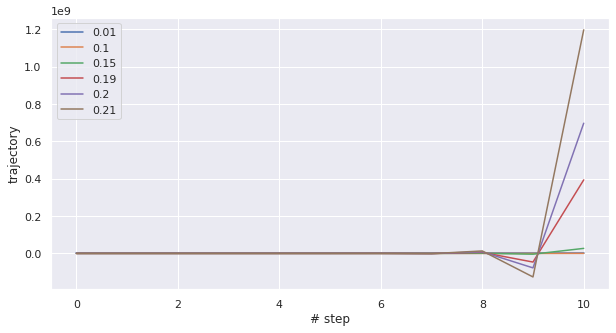

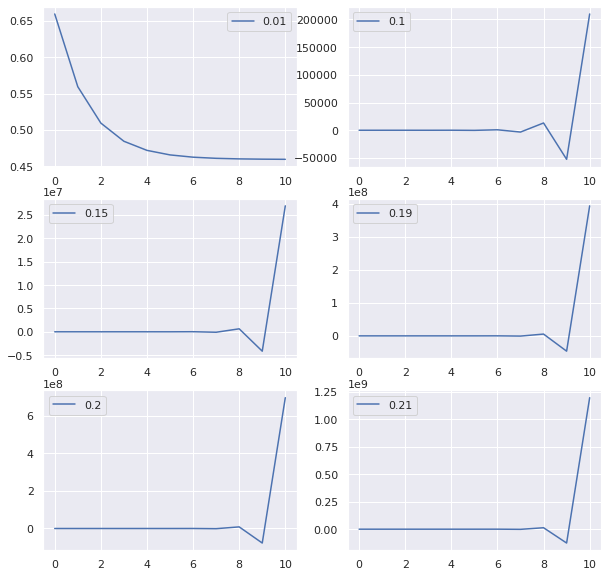

In [ ]:
def plot_trajectory(mus, results):
  plt.figure(figsize=(10, 5))

  for i in range(len(mus)):
    plt.plot(results[i], label=mus[i])

  plt.xlabel('# step')
  plt.ylabel('trajectory')
  plt.legend(loc='best')
  plt.show()


  n = len(mus)
  # plt.figure(figsize=(10, 5))
  fig, axs = plt.subplots(n//2, 2, figsize=(10, 10)) 
  for i in range(len(mus)):
    # plt.figure(figsize=(10, 5))
    axs[i//2, i%2].plot(results[i], label=mus[i])
    # axs[i//2, i%2].xlabel('# step')
    # axs[i//2, i%2].ylabel('trajectory')
    axs[i//2, i%2].legend(loc='best')

  plt.show()

plot_trajectory(mus, results)

The village decided to lay cable using new technology. That's why the price of the cable changed to:

$$
p(d) = |d|
$$

Write new function `P`, `dP`. Plot graphs for various $x$ and $w$.

In [ ]:
def P(w, x):
    (w - x).abs().sum()
    
def dP(w, x):
    res = np.zeros_like(x)
    res[w > x] = 1
    res[w < x] = -1
    res[w == x] = np.random.uniform(-1, 1, res.shape[0])[w == x]
    return res.sum()

Write new analytical solytion $w^*$

Let's consider $|x| = \max\{x, -x\}$ and organize indexes with rule $x_1 < x_2 < \dots < x_i < x_{i+1} < \dots < x_{n}$. Then using Dubovitsky - Milutin theorem we can obtain: $$\nabla_{\omega} P (\omega, x) = \begin{cases} -1, & \text{ if } \omega < x_1 \\ 1, & \text{ if } \omega > x_1 \\ \text{conv}\{-1, 1\}, & \text{ if } \omega = x_1 \end{cases} + \dots + \begin{cases} -1, & \text{ if } \omega < x_n \\ 1, & \text{ if } \omega > x_n \\ \text{conv}\{-1, 1\}, & \text{ if } \omega = x_n \end{cases} = 0 \Rightarrow $$

The number of -1 and 1 must be the same. Therefore, if $n$ is odd then we will chose $\omega^* = \text{median}\{x_1, x_2, ~_{\dots}, x_n\}$, if n is even then  $\forall~ \omega \in \text{conv} \{x_{\frac{n}{2}}, x_{\frac{n}{2} + 1}\} \Rightarrow w^*=w$

Plot loss trajectory for new $p(d)$.

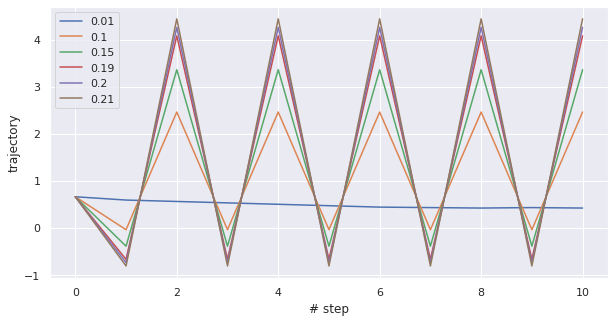

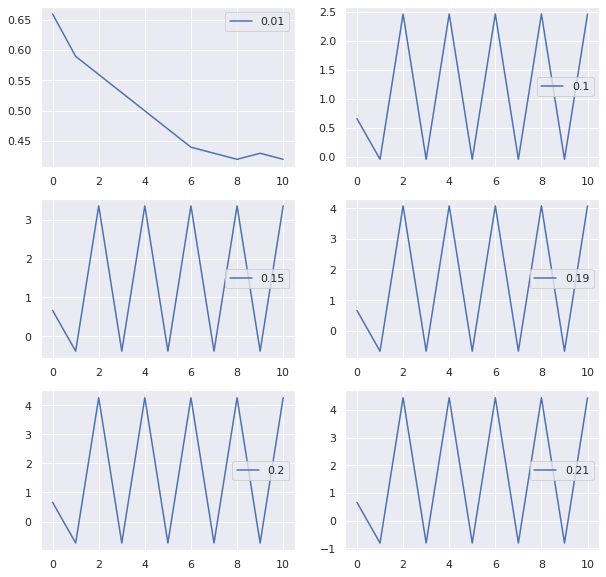

In [ ]:
### YOUR CODE

results = []
mus = [0.01, 0.1, 0.15, 0.19, 0.2, 0.21]
w0, Nsteps = x.mean()+0.2, 10

for mu in tqdm(mus):
  results.append(gradient_descent(x, dP, w0, mu, Nsteps))

plot_trajectory(mus, results)

After several years, the goverment propose to destroy the first station but choose locations for two new stations. In this conditions cost of connecting all house calculated by new formula:

$$
P(w_1, w_2, x) = \sum\limits_{i=1}^N p(d_i) = \sum\limits_{i=1}^N p\left(\min\left(\left|w_1 - x_i\right|, \left|w_2 - x_i\right|\right)\right)
$$

Write new `P`, `dP`. 

In [ ]:
def P(w1, w2, x):
  res = np.zeros((2, x.shape[0]))
  res[0] = np.abs(w1 - x)
  res[1] = np.abs(w2 - x)
  return res.min(axis=0).sum()

def dP(w1, w2, x):
  # dP/dw1
  mask1 = -np.abs(w1-x) > - np.abs(w2-x)
  mask2 = -np.abs(w1-x) < - np.abs(w2-x)
  mask3 = -np.abs(w1-x) == - np.abs(w2-x)
  mask_in1 = w1 > x
  mask_in2 = w1 < x
  mask_in3 = w1 == x
  dw1 = np.zeros_like(x)
  dw1[mask1 * mask_in1] = 1
  dw1[mask1 * mask_in2] = -1
  dw1[mask1 * mask_in3] = np.random.uniform(-1, 1, x.shape[0])[mask1 * mask_in3]

  dw1[mask2] = 0

  dw1[mask3 * mask_in1] = np.random.uniform(0, 1, x.shape[0])[mask3 * mask_in1]
  dw1[mask3 * mask_in2] = np.random.uniform(-1, 0, x.shape[0])[mask3 * mask_in2]
  dw1[mask3 * mask_in3] = np.random.uniform(-1, 1, x.shape[0])[mask3 * mask_in3]

  # dw1 *= -1

  dw1 = dw1.sum()

  # dP/dw2
  mask1 = -np.abs(w2-x) > - np.abs(w1-x)
  mask2 = -np.abs(w2-x) < - np.abs(w1-x)
  mask3 = -np.abs(w2-x) == - np.abs(w1-x)
  mask_in1 = w2 > x
  mask_in2 = w2 < x
  mask_in3 = w2 == x
  dw2 = np.zeros_like(x)
  dw2[mask1 * mask_in1] = 1
  dw2[mask1 * mask_in2] = -1
  dw2[mask1 * mask_in3] = np.random.uniform(-1, 1, x.shape[0])[mask1 * mask_in3]

  dw2[mask2] = 0

  dw2[mask3 * mask_in1] = np.random.uniform(0, 1, x.shape[0])[mask3 * mask_in1]
  dw2[mask3 * mask_in2] = np.random.uniform(-1, 0, x.shape[0])[mask3 * mask_in2]
  dw2[mask3 * mask_in3] = np.random.uniform(-1, 1, x.shape[0])[mask3 * mask_in3]

  # dw2 *= -1

  dw2 = dw2.sum()

  return dw1, dw2

Plot  $P(w_1, w_2), \nabla P(w_1, w_2)$ for different number of houses $N$. Comment on what happens as you increase $N$.

In [ ]:
### YOUR CODE

w1 = np.arange(-10, 10, 0.1)
w2 = np.arange(-10, 10, 0.1)
nn = np.arange(5, 25, 4)
P_mas_n = np.zeros((nn.shape[0], w1.shape[0], w2.shape[0]))
dw1_n = np.zeros_like(P_mas_n)
dw2_n = np.zeros_like(P_mas_n)
for ni in tqdm(range(nn.shape[0])):
  x = np.random.rand(nn[ni]) * l
  for i in range(P_mas_n.shape[1]):
    for j in range(P_mas_n.shape[2]):
      P_mas_n[ni, i, j] = P(w1[i], w2[j], x)
      dw1_n[ni, i, j], dw2_n[ni, i, j] = dP(w1[i], w2[j], x)



In [ ]:
import plotly.graph_objects as go
for ni in range(nn.shape[0]):
  print('N = ', nn[ni])
  fig = go.Figure(data=[go.Surface(z=P_mas_n[ni], x=w1, y=w2)])
  fig.update_layout(title=r'P(w_1, w_2, x)', autosize=False,
                    width=500, height=500,
                    margin=dict(l=65, r=50, b=65, t=90))
  fig.show()

N =  5


N =  9


N =  13


N =  17


N =  21


In [ ]:
import plotly.graph_objects as go
for ni in range(nn.shape[0]):
  print('N = ', nn[ni])
  fig = go.Figure(data=[go.Surface(z=dw1_n[ni], x=w1, y=w2)])
  fig.update_layout(title=r'P(w_1, w_2, x)', autosize=False,
                    width=500, height=500,
                    margin=dict(l=65, r=50, b=65, t=90))
  fig.show()

N =  5


N =  9


N =  13


N =  17


N =  21


In [ ]:
import plotly.graph_objects as go
for ni in range(nn.shape[0]):
  print('N = ', nn[ni])
  fig = go.Figure(data=[go.Surface(z=dw2_n[ni], x=w1, y=w2)])
  fig.update_layout(title=r'P(w_1, w_2, x)', autosize=False,
                    width=500, height=500,
                    margin=dict(l=65, r=50, b=65, t=90))
  fig.show()

N =  5


N =  9


N =  13


N =  17


N =  21


Write new `gradient_descent`, which returns the entire optimization trajectory $(w_k)$ after a fixed number of steps and draws the process on the graphs $P$ and $\nabla P$ that were above. To ease visualization try to use `ax.quiver`

In [ ]:
def gradient_descent(x, dP, w0, mu, Nsteps):
    trajectory = np.zeros((Nsteps + 1, 2))
    trajectory[0] = w0
    for i in range(Nsteps):
      trajectory[i + 1] = trajectory[i] - mu * np.array(dP(*trajectory[i], x))

    return trajectory

In [ ]:
### YOUR CODE

w1 = np.arange(-1, 2, 0.05)
w2 = np.arange(-1, 2, 0.05)

mus = [0.01, 0.1, 0.15, 0.19, 0.2, 0.21]
w0, Nsteps = np.array([0., 0.]), 10

trajectories = np.zeros((len(mus), Nsteps+1, 2))

for i in tqdm(range(trajectories.shape[0])):
  trajectories[i, :, :] = gradient_descent(x, dP, w0, mus[i], Nsteps)



In [ ]:
from matplotlib.colors import LogNorm
# w1_min, w1_max = -10, 10
# w2_min, w2_max = -10, 10
# wstep = 0.1

w1m, w2m = np.meshgrid(w1, w2)



P_mas = np.zeros((w1.shape[0], w2.shape[0]))
dw1 = np.zeros_like(P_mas)
dw2 = np.zeros_like(P_mas)
for i in tqdm(range(P_mas.shape[0])):
  for j in range(P_mas.shape[1]):
    P_mas[i, j] = P(w1[i], w2[j], x)
    dw1[i, j], dw2[i, j] = dP(w1[i], w2[j], x)

# w1m.shape, w2m.shape

In [ ]:
# fig, ax = plt.subplots(figsize=(10, 6))

# ax.contour(w1m, w2m, P_mas, levels=np.logspace(0, 5, 35), norm=LogNorm(), cmap=plt.cm.jet)
# ax.quiver(w1m, w2m, w1m - dw1, w2m - dw2, alpha=.5)
# # ax.plot(*minima_, 'r*', markersize=18)

# ax.set_xlabel('$\omega_1$')
# ax.set_ylabel('$\omega_2$')

# # ax.set_xlim((xmin, xmax))
# # ax.set_ylim((ymin, ymax))

# plt.show()

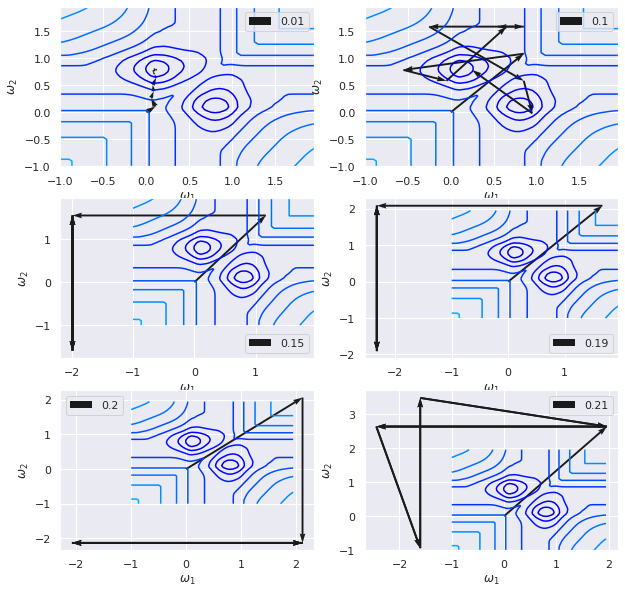

In [ ]:
n = len(mus)
fig, ax = plt.subplots(n//2,2, figsize=(10, 10))
for i in range(len(mus)):
  ax[i//2, i%2].contour(w1, w2, P_mas, levels=np.logspace(0, 5, 35), norm=LogNorm(), cmap=plt.cm.jet)
  ax[i//2, i%2].quiver(trajectories[i, :-1, 0], trajectories[i, :-1,1], trajectories[i, 1:, 0] - trajectories[i, :-1,0],
            trajectories[i, 1: , 1] - trajectories[i, :-1, 1], scale_units='xy', angles='xy', scale=1, color='k', label=mus[i])
  # ax.plot(*minima_, 'r*', markersize=18)

  ax[i//2, i%2].set_xlabel('$\omega_1$')
  ax[i//2, i%2].set_ylabel('$\omega_2$')
  ax[i//2, i%2].legend(loc='best')

  # ax.set_xlim((xmin, xmax))
  # ax.set_ylim((ymin, ymax))

plt.show()


  

Construction is almost underway, but new safety regulations do not allow stations to be on the distance more than 1/2:
 
$$
\left|w_1 - w_2\right| \leq \dfrac{l}{2}
$$

Plot our feasible set. Is it convex?

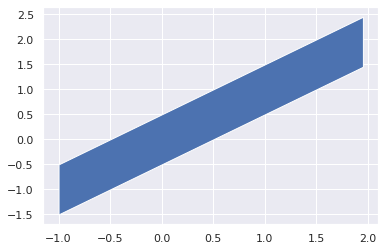

In [ ]:
### YOUR CODE
plt.fill_between(w1, w1-l/2,w1+l/2)
plt.show()

Yes, our feasible set is convex.

Write `conditional_SGD`, which returns the entire optimization trajectory $(w_k)$ after a fixed number of steps and draws the process on the graphs $P$ and $\nabla P$ that were above.

The conditional gradient descent method consists in making a gradient step and then checking if the obtained point belongs to the feasible set. If it belongs to the target set, the algorithm continues, otherwise a projection to the feasible set is made.

In [ ]:
def proj_on_line(x, a=1, b=0): # dist between (x1, x2) and line (x, ax+b)
  t0 = np.array([0, b])
  t = x - t0
  line = np.array([1, a])
  pra = line * np.dot(t, line) / np.linalg.norm(line)**2
  return pra + t0

def projection(w, l):
  if -l/2 + w[0] <= w[1] <= l/2 + w[0]:
    return w
  else:
    p1 = proj_on_line(w, a=1, b=l/2)
    p2 = proj_on_line(w, a=1, b=-l/2)
    if np.linalg.norm(p1 - w) > np.linalg.norm(p2 - w):
      return p2
    else:
      return p1




In [ ]:
def conditional_SGD(x, dP_sigma, w0, mu, Nsteps, p=0.4):
  trajectory = np.zeros((Nsteps + 1, 2))
  trajectory[0] = w0
  for i in range(Nsteps):
    trajectory[i + 1] = trajectory[i] - mu * np.array(dP(*trajectory[i], x))
    if np.abs(trajectory[i + 1, 0] - trajectory[i + 1, 1]) > l/2:
      trajectory[i + 1] = projection(trajectory[i + 1], l)

  return trajectory

In [ ]:
### YOUR CODE
w1 = np.arange(-1, 2, 0.05)
w2 = np.arange(-1, 2, 0.05)

mus = [0.01, 0.1, 0.15, 0.19, 0.2, 0.21]
w0, Nsteps = np.array([0., 0.]), 50

trajectories = np.zeros((len(mus), Nsteps+1, 2))

for i in tqdm(range(trajectories.shape[0])):
  trajectories[i, :, :] = conditional_SGD(x, dP, w0, mus[i], Nsteps)

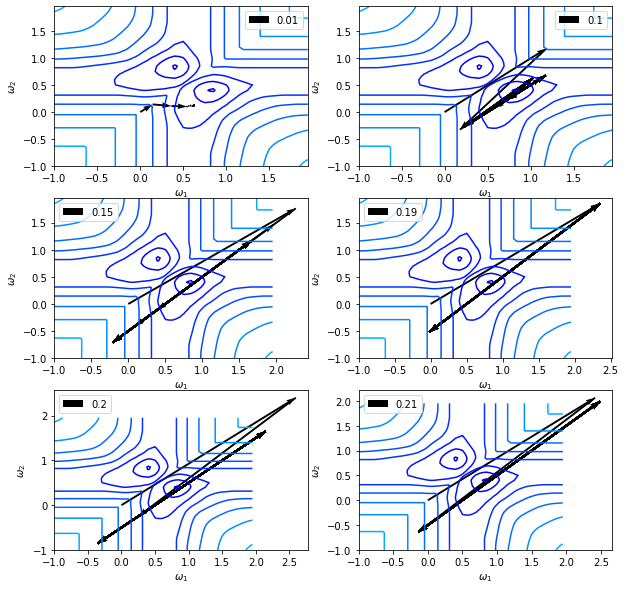

In [ ]:
n = len(mus)
fig, ax = plt.subplots(n//2,2, figsize=(10, 10))
for i in range(len(mus)):
  ax[i//2, i%2].contour(w1, w2, P_mas, levels=np.logspace(0, 5, 35), norm=LogNorm(), cmap=plt.cm.jet)
  ax[i//2, i%2].quiver(trajectories[i, :-1, 0], trajectories[i, :-1,1], trajectories[i, 1:, 0] - trajectories[i, :-1,0],
            trajectories[i, 1: , 1] - trajectories[i, :-1, 1], scale_units='xy', angles='xy', scale=1, color='k', label=mus[i])
  # ax.plot(*minima_, 'r*', markersize=18)

  ax[i//2, i%2].set_xlabel('$\omega_1$')
  ax[i//2, i%2].set_ylabel('$\omega_2$')
  ax[i//2, i%2].legend(loc='best')

  # ax.set_xlim((xmin, xmax))
  # ax.set_ylim((ymin, ymax))

plt.show()

We have same loss function

$$
P(w, x) = \sum\limits_{i=1}^N p(d_i) = \sum\limits_{i=1}^N p(|w - x_i|),
$$

where $p(d) = d^2$

Write functions `P, dP, ddP`. `ddP` has to return hessian of loss function

In [ ]:
def P(w, x):
    ### YOUR CODE
    return ((w - x)**2).sum()

def dP(w, x):
    ### YOUR CODE
    return 2 * (w - x).sum()

def ddP(w, x):
    ### YOUR CODE
    return 2 + np.zeros_like(w)

Plot `ddP` on the range  (0,l)

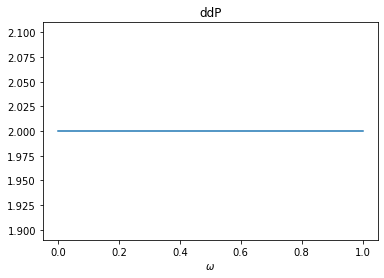

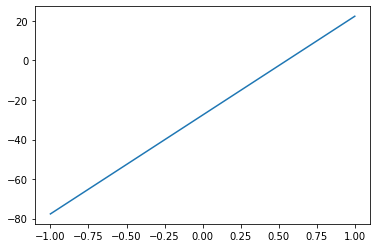

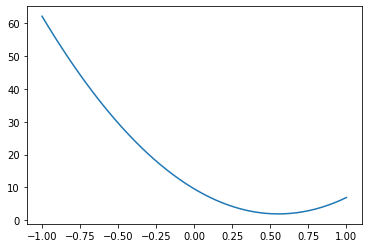

In [ ]:
### YOUR CODE
plt.plot(np.linspace(0, l, 2), ddP(np.linspace(0, l, 2), x))
plt.title('ddP')
plt.xlabel(r'$\omega$')
plt.show()


plt.plot(np.linspace(-1, 1, 50), [dP(w, x) for w in np.linspace(-1, 1, 50)])
plt.show()
plt.plot(np.linspace(-1, 1, 50), [P(w, x) for w in np.linspace(-1, 1, 50)])
plt.show()

Write function `newton_descent`, which return all optimization trajectory. Update rule:

$$
w_{i+1} = w_{i} - \nabla^{2} f\left(w_{i}\right)^{-1} \nabla f\left(w_{i}\right)
$$

In [ ]:
def newton_descent(x, dP, ddP, w0, Nsteps):
    ### YOUR CODE
    trajectory = np.zeros((Nsteps + 1))
    trajectory[0] = w0
    for i in range(Nsteps):
      # print(dP(trajectory[i], x))
      trajectory[i + 1] = trajectory[i] - 0.01 / ddP(trajectory[i], x) * dP(trajectory[i], x)
    return trajectory

Investigate the behavior of Newton's method depending on the different initial point $w_0$.

In [ ]:
### YOUR CODE
n_w0 = 1
Nsteps = 100
w0_list = np.random.uniform(x.min(), x.max(), n_w0)
w0_list = np.array([2.])
trajectories = np.zeros((w0_list.shape[0], Nsteps + 1))
for i in tqdm(range(w0_list.shape[0])):
  trajectories[i] = newton_descent(x, dP, ddP, w0_list[i], Nsteps)

for i in range(trajectories.shape[0]):
  plt.plot(trajectories[i], label=w0_list[i])
  
plt.xlabel('$\omega$')
plt.ylabel('$P$')
plt.legend(loc='best')
plt.show()

NameError: ignored

Write function `multi_newton`, which solve 2D task:
$$
P(w_1, w_2, x) = \sum\limits_{i=1}^N p(d_i) = \sum\limits_{i=1}^N p\left(\min\left(\left|w_1 - x_i\right|, \left|w_2 - x_i\right|\right)\right)
$$

with  $p(d) = d^3$ using Newton method and return optimization trajectory. Compare results with gradient descent.

In [ ]:
def P(w1, w2, x):
    ### YOUR CODE
    return 

def dP(w1, w2, x):
    ### YOUR CODE
    return 

def ddP(w1, w2, x):
    ### YOUR CODE
    return 

In [ ]:
def multi_newton(x, dP, ddP, w0, Nsteps):
    ### YOUR CODE
    return trajectory

In [ ]:
### Gradient descent trajectory

In [ ]:
### Newton descent trajectory

## Projected gradient descent

Find projection on the $S$ set $\pi_S (y) = \pi$ if: 

$$
S = \{x \in \mathbb{R}^n \mid Ax = b, A \in \mathbb{R}^{m \times n}, b \in \mathbb{R}^{m}\}, y \notin S
$$

Hint: Check [fmin.xyz](https://fmin.xyz) 

<font color="lime"> ==YOUR ANSWER== </font>

For following problem:

$$
\left\{ \begin{array}{l} 
\displaystyle \big\lVert Ax - b \big\rVert_2^2 \longrightarrow \min_{x \in \mathbb{R}^n}, \\\\[-1em]
Cx = d.
\end{array} \right. \ \ \begin{array}{l}
A \in \mathbb{R}^{m \times n}, \ m \geq n, \ \text{rg}\, A = n \\
C \in \mathbb{R}^{k \times n}, \ k \leq n, \ \text{rg}\, C = k
\end{array} \ b \in \mathbb{R}^m, \ d \in \mathbb{R}^k
$$

* Write KKT conditions;
* Find $x^\ast$ - solution;

<font color="lime"> ==YOUR ANSWER== </font>

Implement projected gradient descent for following task.

$$
\left\{ \begin{array}{l} 
\displaystyle \big\lVert Ax - b \big\rVert_2^2 \longrightarrow \min_{x \in \mathbb{R}^n}, \\\\[-1em]
Cx = d.
\end{array} \right. \ \ \begin{array}{l}
A \in \mathbb{R}^{m \times n}, \ m \geq n, \ \text{rg}\, A = n \\
C \in \mathbb{R}^{k \times n}, \ k \leq n, \ \text{rg}\, C = k
\end{array} \ b \in \mathbb{R}^m, \ d \in \mathbb{R}^k
$$

Compare with analytical solution and `scipy.optimize`

In [ ]:
import numpy as np

In [ ]:
np.random.seed(1)

A = np.random.randn(100, 20)
b = np.random.randn(100)

C = np.random.randn(10, 20)
d = np.random.randn(10)

In [ ]:
def f(x):
    ### YOUR CODE
    return 

In [ ]:
def proj(C, d, x):
    ### YOUR CODE
    return 

In [ ]:
x = np.zeros(20)
### Projected gradient descent
...

Comparison with `scipy.optimize`

In [ ]:
### YOUR CODE

Comparison with analytical solution

In [ ]:
### YOUR CODE

## Strongly convex function, when Polyak momentum will not converge.
Show empirically, that there is an example (see this [paper](https://arxiv.org/pdf/1408.3595.pdf) - page 23) of the Strongly convex function. 
* Find the specific funtion $f(x)$. Prove, that it is strongly convex function. Find the Lipschitz constant $L$ of a $\nabla f(x)$ and strong convexity constant $\mu$.
* Implement heavy-ball method and show its divergence with specific choice of hyperparameters.
* Try to vary hyperparameters slightly, write down your observations.

In [ ]:
### YOUR CODE HERE